In [2]:
#import packages
import os
import torch
import pickle
import numpy as np
import pandas as pd
import time
import shutil #for copying configs (directory operations)
import queue #for managing checkpoints

In [3]:
device= torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [4]:
config_path = "./Configs/Sign-IDD.yaml"
ckpt= "./Checkpoints/final_model.pth"

In [5]:
#import custom modules
from torch import Tensor
import data
from data import load_data
import torchtext_compat
from torchtext_compat import make_data_iterator, Batch, TextField, RawField
#import batch
#from batch import Batch
from helpers import load_config, set_seed, load_checkpoint, log_cfg, make_model_dir, make_logger, ConfigurationError, get_latest_checkpoint, symlink_update
from model import build_model, Model  
from tensorboardX import SummaryWriter
from constants import TARGET_PAD
from loss import Loss
from builders import build_gradient_clipper, build_optimizer, build_scheduler
from torch.utils.data import Dataset
from plot_videos import plot_video, alter_DTW_timing
from prediction import validate_on_data

# Train Manager Class

In [6]:
class TrainManager:
    def __init__(self, model: Model, config: dict, test= False):
        train_config= config["training"]  #load the configs specific to training from the yaml file
        model_dir= train_config["model_dir"]  #get the dir where model checkpoints and logs are stored
        model_continue = train_config.get("continue", True)  #continue from the latest checkpoint if true

        #if directory does not exist, cannot continue from anything, if in test mode, force continuation
        if not os.path.isdir(model_dir):
            model_continue = False
        if test:
            model_continue = True
            
        self.use_cuda = False

        #create model dir if it doesnt exist
        self.model_dir = make_model_dir(train_config["model_dir"],
                                overwrite=train_config.get("overwrite", False),
                                model_continue=model_continue)

        #logger setup
        self.logger = make_logger(model_dir=self.model_dir)
        self.logging_freq = train_config.get("logging_freq", 100)
        self.tb_writer = SummaryWriter(log_dir=self.model_dir+"/tensorboard/") 
        self.valid_report_file = "{}/validations.txt".format(self.model_dir)  #file where validation scores will be written
        
        #model
        self.model = model  #store model
        self.pad_index = self.model.pad_index
        self.bos_index = self.model.bos_index
        self._log_parameters_list()  #log model parameters for reference

        #initialise loss object with loss function (L1 loss) and padding info
        self.target_pad = TARGET_PAD
        self.loss = Loss(cfg=config, target_pad=self.target_pad)

        #do gradient normalisation per batch
        self.normalization = "batch"

        #optimisation settings
        self.learning_rate_min = train_config.get("learning_rate_min", 1.0e-8)
        self.clip_grad_fun = build_gradient_clipper(config=train_config)
        self.optimizer = build_optimizer(config=train_config, parameters=model.parameters())  #adam

        #validation and early stopping
        self.validation_freq = train_config.get("validation_freq", 1000)
        self.ckpt_best_queue = queue.Queue(maxsize=train_config.get("keep_last_ckpts", 1))  #maintain a queue for best checkpoints
        self.ckpt_queue = queue.Queue(maxsize=1)  

        #setup evaluation metrics and early stopping criteria
        self.eval_metric = train_config.get("eval_metric", "dtw").lower()
        if self.eval_metric not in ['bleu', 'chrf', "dtw"]:
            raise ConfigurationError("Invalid setting for 'eval_metric', "
                                     "valid options: 'bleu', 'chrf', 'DTW'")

        self.early_stopping_metric = train_config.get("early_stopping_metric", "eval_metric") #choose which metric to use for early stopping

        if self.early_stopping_metric in ["loss", "dtw"]: #if using loss or dtw, we want lower values, so minimize=true
            self.minimize_metric = True
        else:
            raise ConfigurationError("Invalid setting for 'early_stopping_metric', "
                                    "valid options: 'loss', 'dtw',.")

        #learning rate scheduling (plateau)
        self.scheduler, self.scheduler_step_at = build_scheduler(
            config=train_config,
            scheduler_mode="min" if self.minimize_metric else "max",
            optimizer=self.optimizer,
            hidden_size=config["model"]["encoder"]["hidden_size"]) 

        #data and batch handling
        self.level = "word"  #tokenization level
        self.shuffle = train_config.get("shuffle", True)  #shuffling enabled
        self.epochs = train_config["epochs"]
        self.batch_size = train_config["batch_size"]  #for both training and evaluation
        self.batch_type = "sentence"
        self.eval_batch_size = train_config.get("eval_batch_size",self.batch_size)
        self.eval_batch_type = train_config.get("eval_batch_type",self.batch_type)
        self.batch_multiplier = train_config.get("batch_multiplier", 1)  #accumulate gradient over 1 batch only (no gradient accumulation)

        #decoding setup
        self.max_output_length = train_config.get("max_output_length", None)  #max length for decoder output(used in sequence generation)

        #device setup
        self.device = torch.device("cuda" if train_config["use_cuda"] and torch.cuda.is_available() else "cpu")
        self.model.to(self.device)
        self.loss.to(self.device)

        # initialize training statistics
        self.steps = 0
        # stop training if this flag is True by reaching learning rate minimum
        self.stop = False
        self.total_tokens = 0
        self.best_ckpt_iteration = 0
        # initial values for best scores
        self.best_ckpt_score = np.inf if self.minimize_metric else -np.inf
        # comparison function for scores
        self.is_best = lambda score: score < self.best_ckpt_score \
            if self.minimize_metric else score > self.best_ckpt_score

        ## Checkpoint restart
        # If continuing
        #if model_continue:
            # Get the latest checkpoint
        #    ckpt = get_latest_checkpoint(model_dir)
        #    if ckpt is None:
        #        self.logger.info("Can't find checkpoint in directory %s", ckpt)
        #    else:
        #        self.logger.info("Continuing model from %s", ckpt)
        #        self.init_from_checkpoint(ckpt)

        # Skip frames
        self.skip_frames = config["data"].get("skip_frames", 1)




    #function to save a checkpoint
    def _save_checkpoint(self, type="every") -> None:
        # Define model path
        model_path = "{}/{}_{}.ckpt".format(self.model_dir, self.steps, type)
        # Define State
        state = {
            "steps": self.steps,
            "total_tokens": self.total_tokens,
            "best_ckpt_score": self.best_ckpt_score,
            "best_ckpt_iteration": self.best_ckpt_iteration,
            "model_state": self.model.state_dict(),
            "optimizer_state": self.optimizer.state_dict(),
            "scheduler_state": self.scheduler.state_dict() if \
            self.scheduler is not None else None,
        }
        #save
        torch.save(state, model_path)

        #if this is the best checkpoint, add it to the best checkpoint queue
        if type == "best":
            if self.ckpt_best_queue.full():
                to_delete = self.ckpt_best_queue.get()  # delete oldest ckpt
                try:
                    os.remove(to_delete)
                except FileNotFoundError:
                    self.logger.warning("Wanted to delete old checkpoint %s but "
                                        "file does not exist.", to_delete)

            self.ckpt_best_queue.put(model_path)

            best_path = "{}/best.ckpt".format(self.model_dir)
            try:
                # create/modify symbolic link for best checkpoint
                symlink_update("{}_best.ckpt".format(self.steps), best_path)
            except OSError:
                # overwrite best.ckpt
                torch.save(state, best_path)

        #if this is just the checkpoint at every validation
        elif type == "every":
            if self.ckpt_queue.full():
                to_delete = self.ckpt_queue.get()  # delete oldest ckpt
                try:
                    os.remove(to_delete)
                except FileNotFoundError:
                    self.logger.warning("Wanted to delete old checkpoint %s but "
                                        "file does not exist.", to_delete)

            self.ckpt_queue.put(model_path)

            every_path = "{}/every.ckpt".format(self.model_dir)
            try:
                # create/modify symbolic link for best checkpoint
                symlink_update("{}_best.ckpt".format(self.steps), every_path)
            except OSError:
                # overwrite every.ckpt
                torch.save(state, every_path)



    #function to initialise from a checkpoint
    def init_from_checkpoint(self, path: str) -> None:
        # Find last checkpoint
        model_checkpoint = load_checkpoint(path=path, use_cuda=self.use_cuda)

        # restore model and optimizer parameters
        self.model.load_state_dict(model_checkpoint["model_state"])
        self.optimizer.load_state_dict(model_checkpoint["optimizer_state"])

        if model_checkpoint["scheduler_state"] is not None and \
                self.scheduler is not None:
            # Load the scheduler state
            self.scheduler.load_state_dict(model_checkpoint["scheduler_state"])

        # restore counts
        self.steps = model_checkpoint["steps"]
        self.total_tokens = model_checkpoint["total_tokens"]
        self.best_ckpt_score = model_checkpoint["best_ckpt_score"]
        self.best_ckpt_iteration = model_checkpoint["best_ckpt_iteration"]

        self.model.to(self.device)



    #train and validate function
    def train_and_validate(self, train_data: Dataset, valid_data: Dataset) -> None:
        #make training iterator
        train_iter= torchtext_compat.make_data_iterator(train_data,      #used to iterate through batches of processed (gloss,skels,file) triplets
                                       train_data.fields,
                                       batch_size= self.batch_size,
                                       shuffle= self.shuffle,
                                       trg_pad_val=TARGET_PAD)
        print(">>> Number of examples in train_data:", len(train_data))
        print(">>> Fields keys:", train_data.fields.keys())
        #print(">>> Example 0 trg:", train_data[0].trg if len(train_data) > 0 else "Empty")

        #print("DEBUG vocab at iterator creation:", train_data.fields["src"].vocab)

        val_step=0

        #training loop
        for epoch_no in range(0,self.epochs):
            #self.logger.info("EPOCH %d", epoch_no + 1)

            if self.scheduler is not None and self.scheduler_step_at == "epoch":  #if scheduler is set to step on epoch, step the lr scheduler at the start of each epoch
                self.scheduler.step(epoch=epoch_no)

            self.model.train()

            # Reset statistics for each epoch.
            start = time.time()
            total_valid_duration = 0
            start_tokens = self.total_tokens
            count = self.batch_multiplier - 1
            epoch_loss = 0

            #loop through each batch
            for batch in iter(train_iter):
                #print(">>> First batch keys:", batch.keys())
                # reactivate training
                self.model.train()

                # create a Batch object from custom batch class
                batch = Batch(batch_dict=batch,
                              pad_index=self.pad_index,
                              target_pad=self.target_pad)

                update= count==0  #if update is true(count-tracks batch_multiplier value), gradients will be stepped this batch

                # Train the model on a batch
                batch_loss = self._train_batch(batch, update=update)
                self.tb_writer.add_scalar("train/train_batch_loss", batch_loss, self.steps)

                count = self.batch_multiplier if update else count
                count -= 1
                epoch_loss += batch_loss.detach().cpu().numpy() 

                if self.scheduler is not None and self.scheduler_step_at == "step" and update:
                    self.scheduler.step()
                
                # log learning progress
                if self.steps % self.logging_freq == 0 and update:
                    elapsed = time.time() - start - total_valid_duration
                    elapsed_tokens = self.total_tokens - start_tokens
                    self.logger.info(
                        "Epoch %d | Step: %d | Batch Loss: %.6f | "
                        "Tokens per Sec: %.0f | Lr: %.6f",
                        epoch_no + 1, self.steps, batch_loss,
                        elapsed_tokens / elapsed,
                        self.optimizer.param_groups[0]["lr"])
                    start = time.time()
                    total_valid_duration = 0
                    start_tokens = self.total_tokens

                #validation block- runs after every validation_freq steps
                if self.steps % self.validation_freq == 0 and update:
                    valid_start_time = time.time()

                    valid_score, valid_loss, valid_references, valid_hypotheses, \
                        valid_inputs, all_dtw_scores, valid_file_paths, valid_bt_f1, valid_mpjpe, \
                            valid_bleu1, valid_bleu4, valid_rouge_l, valid_wer, valid_fid, valid_mpjae  = \
                        validate_on_data(
                            batch_size=self.eval_batch_size,
                            data=valid_data,
                            eval_metric=self.eval_metric,
                            model=self.model,
                            max_output_length=self.max_output_length,
                            loss_function=self.loss,
                            batch_type=self.eval_batch_type,
                            type="val",
                        )

                    val_step+=1

                     # Tensorboard writer
                    self.tb_writer.add_scalar("Valid/loss", valid_loss, self.steps)
                    self.tb_writer.add_scalar("Valid/dtw", valid_score, self.steps)
                    self.tb_writer.add_scalar("Valid/bt_f1", valid_bt_f1, self.steps)
                    self.tb_writer.add_scalar("Valid/mpjpe", valid_mpjpe, self.steps)

                    
                    if self.early_stopping_metric == "loss":
                        ckpt_score = valid_loss
                    elif self.early_stopping_metric == "dtw":
                        ckpt_score = valid_score
                    else:
                        ckpt_score = valid_score

                    #if this validation is better than all previous ones, save as best checkpoint
                    new_best = False
                    self.best = False
                    if self.is_best(ckpt_score):
                        self.best = True
                        self.best_ckpt_score = ckpt_score
                        self.best_ckpt_iteration = self.steps
                        self.logger.info(
                            'Hooray! New best validation result [%s]!',
                            self.early_stopping_metric)
                        if self.ckpt_queue.maxsize > 0:
                            self.logger.info("Saving new checkpoint.")
                            new_best = True
                            self._save_checkpoint(type="best")

                        # generate video samples
                        display = list(range(0, len(valid_hypotheses), int(np.ceil(len(valid_hypotheses) / 13.15))))
                        self.produce_validation_video(
                            output_joints=valid_hypotheses,
                            inputs=valid_inputs,
                            references=valid_references,
                            model_dir=self.model_dir,
                            steps=self.steps,
                            display=display,
                            type="val_inf",
                            file_paths=valid_file_paths,
                        )
                        

                    #save checkpoint after every validation step even if it is not the best 
                    self._save_checkpoint(type="every")

                    if self.scheduler is not None and self.scheduler_step_at == "validation":
                        self.scheduler.step(ckpt_score)
                
                    # append to validation report
                    self._add_report(
                        valid_score=valid_score, valid_loss=valid_loss,
                        eval_metric=self.eval_metric,
                        new_best=new_best, report_type="val",)

                    valid_duration = time.time() - valid_start_time
                    total_valid_duration += valid_duration
                    self.logger.info('Validation result at epoch %d\n'
                                        '\t\t\tStep: %d\n'
                                        '\t\t\tDTW: %.4f | BT-F1: %.4f | MPJPE: %.4f\n'
                                        '\t\t\tBLEU-1: %.4f | BLEU-4: %.4f | ROUGE-L: %.4f\n'
                                        '\t\t\tWER: %.4f | FID: %.4f | MPJAE: %.4f\n'
                                        '\t\t\tLoss: %.4f | Duration: %.2fs',
                                        epoch_no + 1, self.steps,
                                        valid_score, valid_bt_f1, valid_mpjpe,
                                        valid_bleu1, valid_bleu4, valid_rouge_l,
                                        valid_wer, valid_fid, valid_mpjae,
                                        valid_loss, valid_duration
                                    )

                    

                if self.stop:
                    break
                    
            if self.stop:
                self.logger.info(
                    'Training ended since minimum lr %f was reached.',
                     self.learning_rate_min)
                break
                
            if epoch_no % 20 == 0:
                self.logger.info('Epoch %d: Total training loss %.5f', epoch_no,
                                 epoch_loss)

        else:
            self.logger.info('Training ended after %d epochs.', epoch_no+1)
            
        
        self.logger.info('Best validation result at step %d: %.2f %s.',
                         self.best_ckpt_iteration, self.best_ckpt_score,
                         self.early_stopping_metric)
        
        # Save final model weights
        os.makedirs("./Checkpoints", exist_ok=True)
        final_ckpt_path = os.path.join("./Checkpoints", "final_model.pth")
        torch.save(self.model.state_dict(), final_ckpt_path)
        self.logger.info("Final model saved to %s", final_ckpt_path)

        self.tb_writer.close()  # close Tensorboard writer



    #function to generate validation videos (side by side comparision of output and ground truth)
    def produce_validation_video(self, output_joints, inputs, references, display,
                                 model_dir, type, steps="", file_paths=None, dtw_file= None):

        # If not at test
        if type != "test":
            dir_name = model_dir + "/videos/Step_{}/".format(steps)
            if not os.path.exists(model_dir + "/videos/"):
                os.mkdir(model_dir + "/videos/")

        # If at test time
        elif type == "test":
            dir_name = model_dir + "/test_videos/"

        # Create model video folder if not exist
        if not os.path.exists(dir_name):
            os.mkdir(dir_name)

        #generate one video per sample index in display
        for i in display:
            #pull the relevant data
            seq = output_joints[i]
            ref_seq = references[i]
            input = inputs[i]
            
            #create gloss label
            gloss_label = input[0]
            if input[1] != "</s>":  #skip eos tokens
                gloss_label += "_" + input[1]
            if input[2] != "</s>":
                gloss_label += "_" + input[2]
            
            # Alter the dtw timing of the produced sequence using the reference sequence, and collect the DTW score
            timing_hyp_seq, ref_seq_count, dtw_score = alter_DTW_timing(seq, ref_seq)

            #name the file using gloss and score
            video_ext = "{}_{}.mp4".format(gloss_label, "{0:.2f}".format(float(dtw_score)).replace(".", "_"))

            #get sequence id to track source files
            if file_paths is not None:
                sequence_ID = file_paths[i]
            else:
                sequence_ID = None

            #print and log dtw score
            print(sequence_ID + '    dtw: ' + '{0:.2f}'.format(float(dtw_score)))
            if dtw_file != None:
                dtw_file.writelines(sequence_ID + ' ' + '{0:.2f}'.format(float(dtw_score)) + '\n')

            #plot the video
            os.makedirs(dir_name, exist_ok=True)
            plot_video(joints=timing_hyp_seq,
                       file_path=dir_name,
                       video_name=None,
                       references=ref_seq_count,
                       skip_frames=self.skip_frames,
                       sequence_ID=sequence_ID)



    #function to save the skeletons
    def save_skels(self, output_joints, display, model_dir, type, file_paths=None):
        #create pickle output file
        picklefile = open(model_dir + "/phoenix14t.skels", "wb")
        
        #load metadata csv
        csvIn = pd.read_csv(model_dir + "/csv/%s_phoenix2014t.csv" % type, sep='|',encoding='utf-8')
        pickle_list = []

        #loop through selected samples
        for i in display:
            name = file_paths[i]
            #extract metadata
            #video = name[len(os.path.dirname(name))+1:]
            #signer = csvIn[csvIn['id']==video]['signer'].item()
            #gloss = csvIn[csvIn['id']==video]['annotation'].item()
            #text = csvIn[csvIn['id']==video]['translation'].item()
            #extract predicted joint sequences
            seq = output_joints[i].cpu()[:,:-1]
            sign = torch.tensor(seq, dtype = torch.float32)

            #build and store dictionary
            #dict_num = {'name': name, 'signer': signer, 'gloss': gloss, 'text': text, 'sign': sign}

            #pickle_list.append(dict_num)

        pickle.dump(pickle_list, picklefile)
        print("The skeletons of %s date have been saved." % type)
        

        


    def save_skels2(self, output_joints, display, model_dir, type, file_paths=None):
        os.makedirs(model_dir, exist_ok=True)
        output_path = os.path.join(model_dir, f"{type}.skels")

        with open(output_path, "w") as f:
            for i in display:
                sequence = output_joints[i].cpu().numpy()  # shape: [T, 225]
                sequence = sequence.reshape(sequence.shape[0], 75, 3)  # [T, 75, 3]

                frame_strings = []
                for frame in sequence:
                    triplets = [f"{x:.6f},{y:.6f},{z:.6f}" for x, y, z in frame]
                    frame_strings.extend(triplets)  # all frames go in one line

                f.write(" ".join(frame_strings) + "\n")

        print(f"Saved {len(display)} skeleton sequences to '{output_path}'")





    #function to train 1 batch
    def _train_batch(self, batch: Batch, update: bool = True) -> Tensor:
        #compute loss
        batch_loss = self.model.get_loss_for_batch(is_train=True,
                                                          batch=batch,
                                                          loss_function=self.loss)

        #determine what to divide the loss by (for normalisation)
        if self.normalization == "batch":
            normalizer = batch.nseqs
        elif self.normalization == "tokens":
            normalizer = batch.ntokens
        else:
            raise NotImplementedError("Only normalize by 'batch' or 'tokens'")

        
        norm_batch_loss= batch_loss/normalizer
        #divide further so that gradient is accumulated over batch_multiplier
        norm_batch_multiply= norm_batch_loss/self.batch_multiplier
        
        #backpropagate
        norm_batch_multiply.backward()
        
        
        #if gradient clipping function is defined, it is applied to prevent exploding gradients
        if self.clip_grad_fun is not None:
            self.clip_grad_fun(params=self.model.parameters())
        
        #update parameters
        if update:
            self.optimizer.step()
            self.optimizer.zero_grad()

            # increment step counter
            self.steps += 1
        
        #update total count token
        self.total_tokens += batch.ntokens

        return norm_batch_loss
    
    #function to log validation performance after an evaluation step
    def _add_report(self,valid_score: float, valid_loss: float, eval_metric: str, new_best: bool= False, report_type:str="val")->None:
        current_lr=-1;
        #extract the learning rate from the current parameter group
        for param_group in self.optimizer.param_groups:
            current_lr = param_group['lr']
            
        #check for early stopping
        if current_lr < self.learning_rate_min:
            self.stop = True
            
        #log to the validation report file
        if report_type == "val":
            with open(self.valid_report_file, 'a') as opened_file:
                opened_file.write(
                    "Steps: {} Loss: {:.5f}| DTW: {:.3f}|"
                    " LR: {:.6f} {}\n".format(
                        self.steps, valid_loss, valid_score,
                        current_lr, "*" if new_best else ""))
        
    
    #function to write all model parameters to the log
    def _log_parameters_list(self)->None:
        #filter only those parameters whose values are updated during training (trainable parameters)
        model_parameters = filter(lambda p: p.requires_grad,
                                  self.model.parameters())
        
        n_params = sum([np.prod(p.size()) for p in model_parameters])
        self.logger.info("Total params: %d", n_params)
        
        #collect the names of all the trainable parameters
        trainable_params = [n for (n, p) in self.model.named_parameters()
                            if p.requires_grad]
        
        self.logger.info("Trainable parameters: %s", sorted(trainable_params))
        assert trainable_params  #throws assertion error if no trainable parameters found
        

# Train function

In [7]:
def train (cfg_file:str, ckpt):
    cfg= load_config(cfg_file)  #cfg is a dictionary of all the configurations from the yaml file
    set_seed(seed=cfg["training"].get("random_seed", 42)) #for reproducibility
    
    #prepare the dataset and load it using the functions in data.py
    train_data, dev_data, test_data, src_vocab, trg_vocab = load_data(cfg=cfg)
    
    #print("train_data sample:")
    #print("src:", train_data[0].src)
    #print("trg:", train_data[0].trg)
    #print("file_paths:",train_data[0].file_paths)
    
    #instantiate the model
    model = build_model(cfg=cfg, src_vocab=src_vocab, trg_vocab=trg_vocab)
    
    #if there are checkpoints, load parameters from there instead of initialising
    if ckpt is not None and os.path.getsize(ckpt)>0:
        device= torch.device('cuda' if torch.cuda.is_available() and cfg["training"].get("use_cuda", True) else 'cpu')
        model_checkpoint= torch.load(ckpt, map_location= device)
        #model.load_state_dict(model_checkpoint["model_state"]) 
        model.load_state_dict(torch.load(ckpt, map_location=device))
        
    #initialise the train manager class
    trainer = TrainManager(config=cfg, model=model, test=False)
    
    #store a copy of the training config before training loop
    shutil.copy2(cfg_file, trainer.model_dir+"/Sign-IDD.yaml")
    log_cfg(cfg, trainer.logger)

    trainer.train_and_validate(train_data=train_data, valid_data=dev_data)

>> Preprocessing tokens of type: <class 'list'> length: 130
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 130 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 184
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 184 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 198
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 198 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 150
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 150 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 181
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 181 |

2025-07-03 13:57:53,240 Sign-IDD: Iconicity Disentangled Diffusion for Sign Language Production
2025-07-03 13:57:53,242 Total params: 17246720
2025-07-03 13:57:53,242 Trainable parameters: ['ACD.ACD_Denoiser.layer_norm.bias', 'ACD.ACD_Denoiser.layer_norm.weight', 'ACD.ACD_Denoiser.layer_norm_mid.bias', 'ACD.ACD_Denoiser.layer_norm_mid.weight', 'ACD.ACD_Denoiser.layers_mha_ac.dec_layer_norm.bias', 'ACD.ACD_Denoiser.layers_mha_ac.dec_layer_norm.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.layer_norm.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.layer_norm.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.0.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.0.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.3.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.3.weight', 'ACD.ACD_Denoiser.layers_mha_ac.src_trg_att.k_layer.bias', 'ACD.ACD_Denoiser.layers_mha_ac.src_trg_att.k_layer.weight', 'ACD.ACD_Denoiser.layers_mha_ac.

2025-07-03 13:57:53,848 cfg.model.trg_size                 : 225
2025-07-03 13:57:53,848 cfg.model.just_count_in            : False
2025-07-03 13:57:53,848 cfg.model.gaussian_noise           : False
2025-07-03 13:57:53,848 cfg.model.noise_rate               : 5
2025-07-03 13:57:53,849 cfg.model.future_prediction        : 0
2025-07-03 13:57:53,849 cfg.model.encoder.type             : transformer
2025-07-03 13:57:53,849 cfg.model.encoder.num_layers       : 2
2025-07-03 13:57:53,849 cfg.model.encoder.num_heads        : 4
2025-07-03 13:57:53,849 cfg.model.encoder.embeddings.embedding_dim : 512
2025-07-03 13:57:53,850 cfg.model.encoder.embeddings.dropout : 0.0
2025-07-03 13:57:53,850 cfg.model.encoder.hidden_size      : 512
2025-07-03 13:57:53,850 cfg.model.encoder.ff_size          : 2048
2025-07-03 13:57:53,850 cfg.model.encoder.dropout          : 0.0
2025-07-03 13:57:53,850 cfg.model.diffusion.timesteps      : 1000
2025-07-03 13:57:53,851 cfg.model.diffusion.sampling_timesteps : 5
2025-07

>>> Number of examples in train_data: 5
>>> Fields keys: dict_keys(['src', 'trg', 'file_paths'])


2025-07-03 13:57:54,147 Epoch 0: Total training loss 0.19575
2025-07-03 13:57:59,466 Epoch 20: Total training loss 0.05819
2025-07-03 13:58:04,152 Epoch 40: Total training loss 0.04949
2025-07-03 13:58:08,640 Epoch 60: Total training loss 0.04450
2025-07-03 13:58:13,758 Epoch 80: Total training loss 0.04413
2025-07-03 13:58:19,167 Epoch 100: Total training loss 0.04236
2025-07-03 13:58:25,848 Epoch 120: Total training loss 0.04215
2025-07-03 13:58:36,014 Epoch 140: Total training loss 0.04191
2025-07-03 13:58:46,724 Epoch 160: Total training loss 0.04102
2025-07-03 13:58:58,051 Epoch 180: Total training loss 0.04214
2025-07-03 13:59:10,216 Epoch 200: Total training loss 0.03874
2025-07-03 13:59:22,329 Epoch 220: Total training loss 0.03262
2025-07-03 13:59:35,072 Epoch 240: Total training loss 0.03451
2025-07-03 13:59:41,902 Epoch 250 | Step: 250 | Batch Loss: 0.034552 | Tokens per Sec: 85 | Lr: 0.001000
2025-07-03 13:59:42,630 Hooray! New best validation result [dtw]!
2025-07-03 13:59

Too few samples for reliable FID. Returning dummy value.
test/25October_2010_Monday_tagesschau-24    dtw: 54.99


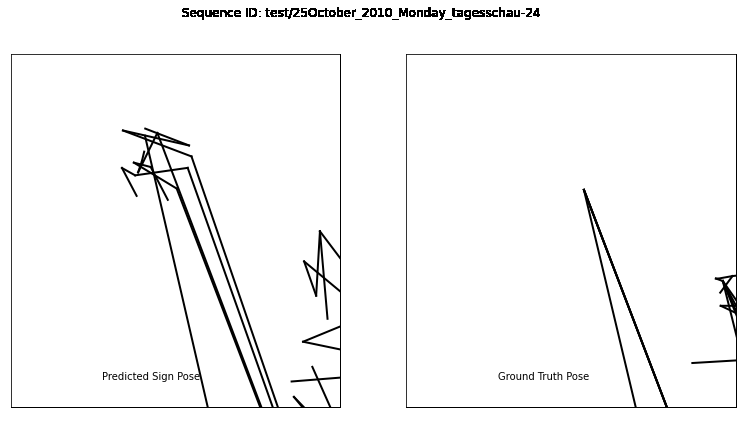

test/14August_2009_Friday_tagesschau-62    dtw: 65.18


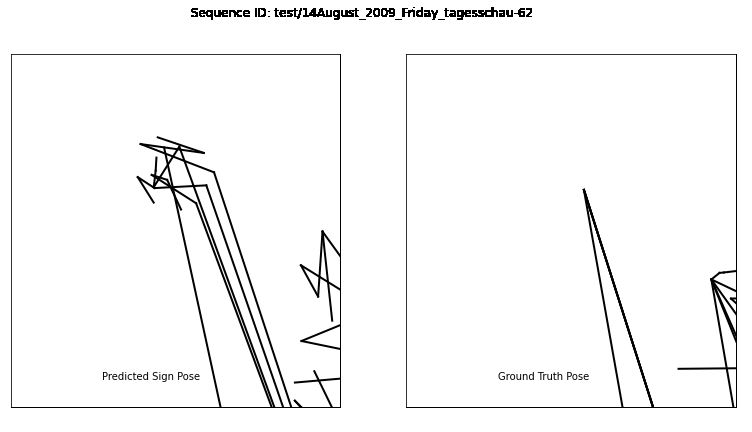

test/15December_2010_Wednesday_tagesschau-37    dtw: 55.84


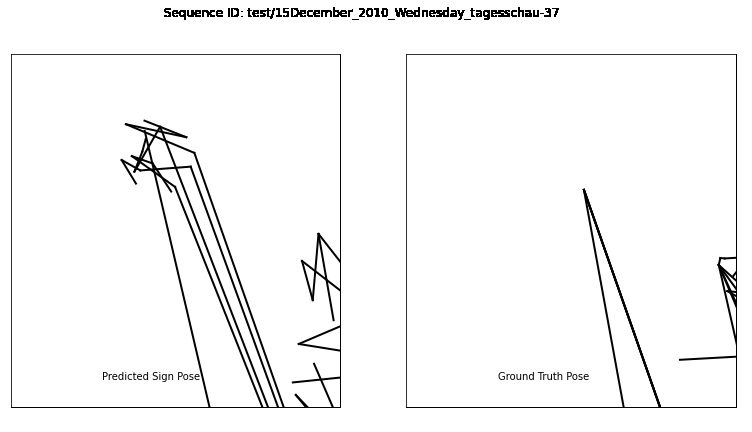

test/10March_2011_Thursday_heute-58    dtw: 71.15


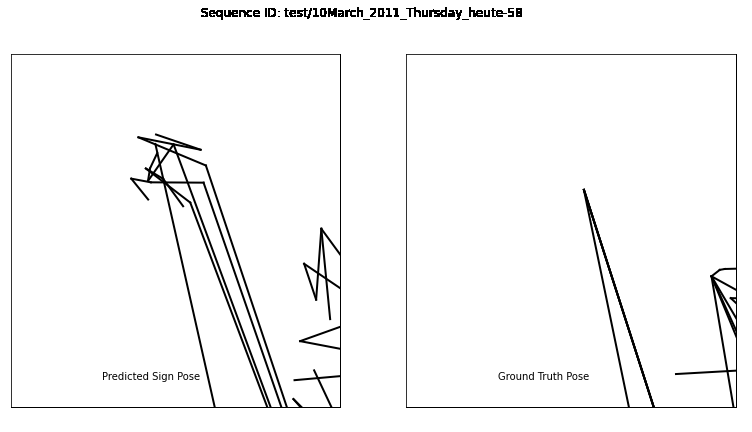

test/25October_2010_Monday_tagesschau-17    dtw: 77.46


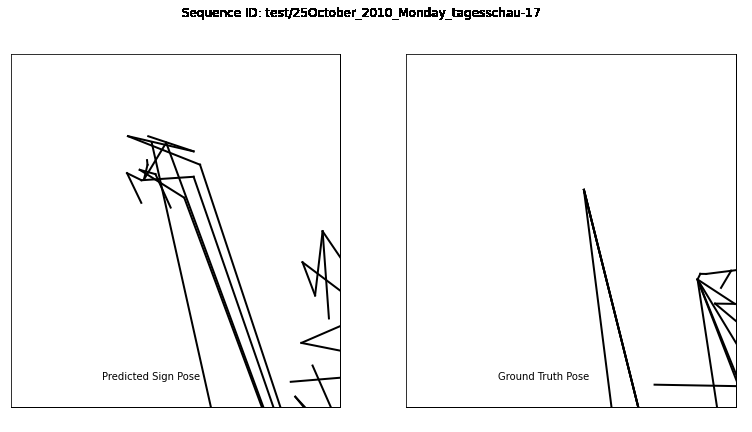

2025-07-03 14:01:45,844 Validation result at epoch 250
			Step: 250
			DTW: 1557.1258 | BT-F1: 0.1702 | MPJPE: 0.6423
			BLEU-1: 1.0000 | BLEU-4: 1.0000 | ROUGE-L: 1.0000
			WER: 0.0000 | FID: 0.0000 | MPJAE: 0.3132
			Loss: 0.1823 | Duration: 123.94s
2025-07-03 14:01:53,403 Epoch 260: Total training loss 0.03338
2025-07-03 14:02:07,145 Epoch 280: Total training loss 0.03489
2025-07-03 14:02:20,369 Epoch 300: Total training loss 0.03290
2025-07-03 14:02:33,656 Epoch 320: Total training loss 0.03480
2025-07-03 14:02:47,420 Epoch 340: Total training loss 0.03182
2025-07-03 14:02:59,573 Epoch 360: Total training loss 0.03285
2025-07-03 14:03:12,494 Epoch 380: Total training loss 0.03009
2025-07-03 14:03:24,581 Epoch 400: Total training loss 0.02922
2025-07-03 14:03:37,460 Epoch 420: Total training loss 0.02740
2025-07-03 14:03:49,479 Epoch 440: Total training loss 0.03602
2025-07-03 14:04:02,196 Epoch 460: Total training loss 0.02946
2025-07-03 14:04:13,894 Epoch 480: Total training loss 

Too few samples for reliable FID. Returning dummy value.
test/25October_2010_Monday_tagesschau-24    dtw: 51.22


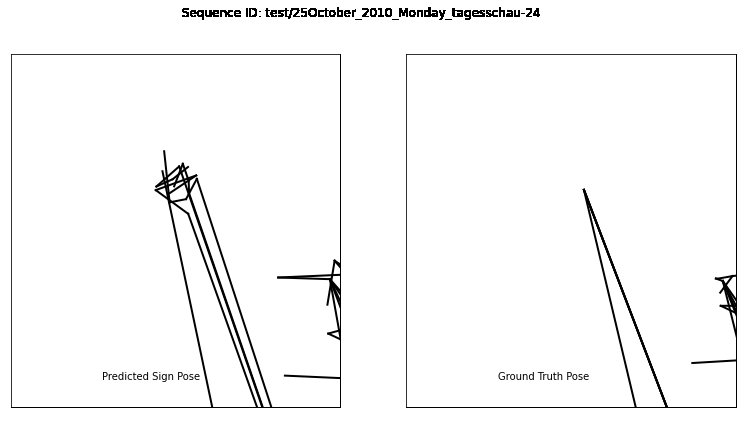

test/14August_2009_Friday_tagesschau-62    dtw: 56.51


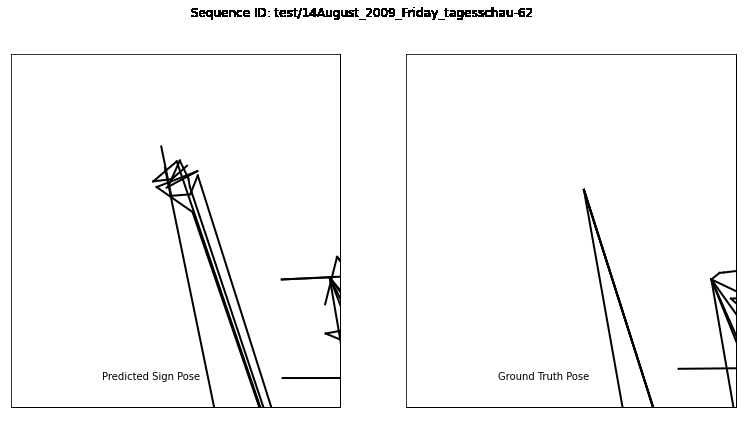

test/10March_2011_Thursday_heute-58    dtw: 63.58


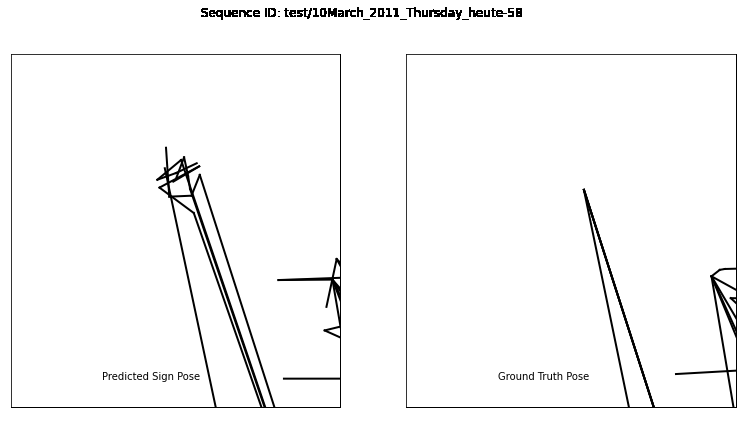

test/15December_2010_Wednesday_tagesschau-37    dtw: 47.88


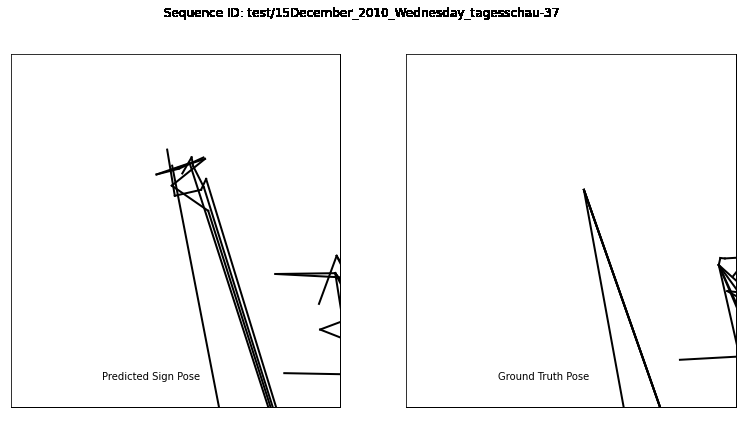

test/25October_2010_Monday_tagesschau-17    dtw: 73.23


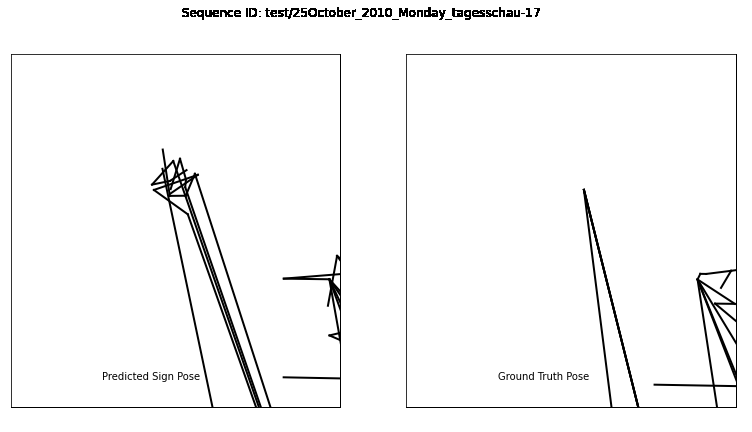

2025-07-03 14:06:34,395 Validation result at epoch 500
			Step: 500
			DTW: 41.2130 | BT-F1: 0.1552 | MPJPE: 0.5774
			BLEU-1: 1.0000 | BLEU-4: 1.0000 | ROUGE-L: 1.0000
			WER: 0.0000 | FID: 0.0000 | MPJAE: 0.2832
			Loss: 0.1542 | Duration: 130.13s
2025-07-03 14:06:34,942 Epoch 500: Total training loss 0.02980
2025-07-03 14:06:46,292 Epoch 520: Total training loss 0.02724
2025-07-03 14:06:57,488 Epoch 540: Total training loss 0.02829
2025-07-03 14:07:08,210 Epoch 560: Total training loss 0.02752
2025-07-03 14:07:18,678 Epoch 580: Total training loss 0.02221
2025-07-03 14:07:29,421 Epoch 600: Total training loss 0.03190
2025-07-03 14:07:38,264 Epoch 620: Total training loss 0.02541
2025-07-03 14:07:47,040 Epoch 640: Total training loss 0.02348
2025-07-03 14:07:56,263 Epoch 660: Total training loss 0.02294
2025-07-03 14:08:04,003 Epoch 680: Total training loss 0.02180
2025-07-03 14:08:11,376 Epoch 700: Total training loss 0.02159
2025-07-03 14:08:19,177 Epoch 720: Total training loss 0.

Too few samples for reliable FID. Returning dummy value.


2025-07-03 14:08:32,443 Validation result at epoch 750
			Step: 750
			DTW: 1757.7036 | BT-F1: 0.1988 | MPJPE: 0.4688
			BLEU-1: 1.0000 | BLEU-4: 1.0000 | ROUGE-L: 1.0000
			WER: 0.0000 | FID: 0.0000 | MPJAE: 0.2291
			Loss: 0.1136 | Duration: 1.11s
2025-07-03 14:08:36,759 Epoch 760: Total training loss 0.02094
2025-07-03 14:08:45,379 Epoch 780: Total training loss 0.02520
2025-07-03 14:08:53,292 Epoch 800: Total training loss 0.02130
2025-07-03 14:08:59,986 Epoch 820: Total training loss 0.01885
2025-07-03 14:09:07,229 Epoch 840: Total training loss 0.02198
2025-07-03 14:09:14,111 Epoch 860: Total training loss 0.01827
2025-07-03 14:09:20,955 Epoch 880: Total training loss 0.01532
2025-07-03 14:09:27,787 Epoch 900: Total training loss 0.01727
2025-07-03 14:09:34,310 Epoch 920: Total training loss 0.01595
2025-07-03 14:09:40,599 Epoch 940: Total training loss 0.01672
2025-07-03 14:09:47,183 Epoch 960: Total training loss 0.01461
2025-07-03 14:09:53,743 Epoch 980: Total training loss 0.

Too few samples for reliable FID. Returning dummy value.


2025-07-03 14:10:01,175 Validation result at epoch 1000
			Step: 1000
			DTW: 7833.7149 | BT-F1: 0.3597 | MPJPE: 0.3459
			BLEU-1: 1.0000 | BLEU-4: 1.0000 | ROUGE-L: 1.0000
			WER: 0.0000 | FID: 0.0000 | MPJAE: 0.1707
			Loss: 0.0719 | Duration: 1.57s
2025-07-03 14:10:01,176 Training ended after 1000 epochs.
2025-07-03 14:10:01,176 Best validation result at step 500: 41.21 dtw.
2025-07-03 14:10:02,197 Final model saved to ./Checkpoints/final_model.pth


In [8]:
train(cfg_file= config_path, ckpt=None)

# Test function

In [1]:
def test(cfg_file,ckpt:str):
    cfg= load_config(cfg_file)
    model_dir=cfg["training"]["model_dir"]
    
    #if ckpt is None:
    #    ckpt = get_latest_checkpoint(model_dir,post_fix="_best")
    #    if ckpt is None:
    #        raise FileNotFoundError("No checkpoint found in directory {}."
    #                                .format(model_dir))
    
    batch_size = cfg["training"].get("eval_batch_size", cfg["training"]["batch_size"])
    batch_type = cfg["training"].get("eval_batch_type", cfg["training"].get("batch_type", "sentence"))
    use_cuda = cfg["training"].get("use_cuda", True)
    eval_metric = cfg["training"]["eval_metric"]
    max_output_length = cfg["training"].get("max_output_length", None)
    
    _, dev_data, test_data, src_vocab, trg_vocab = load_data(cfg=cfg)
    
    data_to_predict = {"dev": dev_data, "test": test_data}
    
    trained_model = build_model(cfg, src_vocab, trg_vocab)
    trained_model.load_state_dict(torch.load("./Checkpoints/final_model.pth", map_location=device))
    
    #model_checkpoint = load_checkpoint(ckpt, use_cuda=use_cuda)
    
    #model = build_model(cfg=cfg, src_vocab=src_vocab, trg_vocab=trg_vocab)
    #model.load_state_dict(model_checkpoint["model_state"])
    
    trainer = TrainManager(model=trained_model, config=cfg, test=True)
    
    #choose the split (dev or test)
    for data_set_name, data_set in data_to_predict.items():
        
        #validate
        valid_score, valid_loss, valid_references, valid_hypotheses, \
        valid_inputs, all_dtw_scores, valid_file_paths, valid_bt_f1, valid_mpjpe, \
        valid_bleu1, valid_bleu4, valid_rouge_l, valid_wer, valid_fid, valid_mpjae  =\
            validate_on_data(
                model=trained_model,
                data=data_set,
                batch_size=batch_size,
                max_output_length=max_output_length,
                eval_metric=eval_metric,
                loss_function=None,
                batch_type=batch_type,
                type="val" if data_set_name != "train" else "train_inf"
            )
        
        score=np.mean(all_dtw_scores)
        
        if not os.path.exists(os.path.join(model_dir, 'test_videos')):
            os.mkdir(os.path.join(model_dir, 'test_videos'))
            
        result_file = os.path.join(model_dir, f"{data_set_name}_metrics.txt")
        with open(result_file, 'w') as f:
            f.write(f"\n===== Evaluation on {data_set_name.upper()} set =====\n")
            f.write(f"DTW Score     : {score:.3f}\n")
            f.write(f"BT F1 Score   : {valid_bt_f1:.3f}\n")
            f.write(f"MPJPE         : {valid_mpjpe:.3f}\n")
            f.write(f"BLEU-1 Score  : {valid_bleu1:.3f}\n")
            f.write(f"BLEU-4 Score  : {valid_bleu4:.3f}\n")
            f.write(f"ROUGE-L Score : {valid_rouge_l:.3f}\n")
            f.write(f"WER Score     : {valid_wer:.3f}\n")
            f.write(f"FID Score     : {valid_fid:.3f}\n")
            f.write(f"MPJPE         : {valid_mpjpe:.3f}\n")
            f.write(f"MPJAE         : {valid_mpjae:.3f}\n")
            

        print(f"\n===== Evaluation on {data_set_name.upper()} set =====")
        print(f"DTW Score     : {score:.3f}")
        print(f"BT F1 Score   : {valid_bt_f1:.3f}")
        print(f"BLEU-1 Score  : {valid_bleu1:.3f}")
        print(f"BLEU-4 Score  : {valid_bleu4:.3f}")
        print(f"ROUGE-L Score : {valid_rouge_l:.3f}")
        print(f"WER Score     : {valid_wer:.3f}")
        print(f"FID Score     : {valid_fid:.3f}")
        print(f"MPJPE         : {valid_mpjpe:.3f}")
        print(f"MPJAE         : {valid_mpjae:.3f}")

        
        #print('DTW Score of %s set: %.3f' %(data_set_name, score))
        # Set which sequences to produce video for
        display = list(range(len(valid_hypotheses)))
        
        trainer.save_skels2(output_joints=valid_hypotheses, display=display, model_dir=model_dir, type=data_set_name, file_paths=valid_file_paths)
        
        trainer.produce_validation_video(
            output_joints=valid_hypotheses,
            inputs=valid_inputs,
            references=valid_references,
            model_dir=model_dir,
            display=display,
            type="test",
            file_paths=valid_file_paths,
            dtw_file=open(result_file, 'a'),
        )

>> Preprocessing tokens of type: <class 'list'> length: 130
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 130 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 184
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 184 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 198
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 198 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 150
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 150 | Frame dim: torch.Size([225])
>> Preprocessing tokens of type: <class 'list'> length: 181
>>> Using NEW tokenize_features with 225-dim
>>> Already tokenized frames, skipping reshaping
>>> Frame count: 181 |

2025-07-03 13:52:29,698 Sign-IDD: Iconicity Disentangled Diffusion for Sign Language Production
2025-07-03 13:52:29,700 Total params: 17246720
2025-07-03 13:52:29,701 Trainable parameters: ['ACD.ACD_Denoiser.layer_norm.bias', 'ACD.ACD_Denoiser.layer_norm.weight', 'ACD.ACD_Denoiser.layer_norm_mid.bias', 'ACD.ACD_Denoiser.layer_norm_mid.weight', 'ACD.ACD_Denoiser.layers_mha_ac.dec_layer_norm.bias', 'ACD.ACD_Denoiser.layers_mha_ac.dec_layer_norm.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.layer_norm.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.layer_norm.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.0.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.0.weight', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.3.bias', 'ACD.ACD_Denoiser.layers_mha_ac.feed_forward.pwff_layer.3.weight', 'ACD.ACD_Denoiser.layers_mha_ac.src_trg_att.k_layer.bias', 'ACD.ACD_Denoiser.layers_mha_ac.src_trg_att.k_layer.weight', 'ACD.ACD_Denoiser.layers_mha_ac.

Using skeleton 1
Using skeleton 1
Using skeleton 1
Using skeleton 1
Using skeleton 1
Too few samples for reliable FID. Returning dummy value.

===== Evaluation on DEV set =====
DTW Score     : 6759.550
BT F1 Score   : 0.295
BLEU-1 Score  : 1.000
BLEU-4 Score  : 1.000
ROUGE-L Score : 1.000
WER Score     : 0.000
FID Score     : 0.000
MPJPE         : 0.346
MPJAE         : 0.171
Saved 5 skeleton sequences to './Models/Base/dev.skels'
test/25October_2010_Monday_tagesschau-17    dtw: 50.64


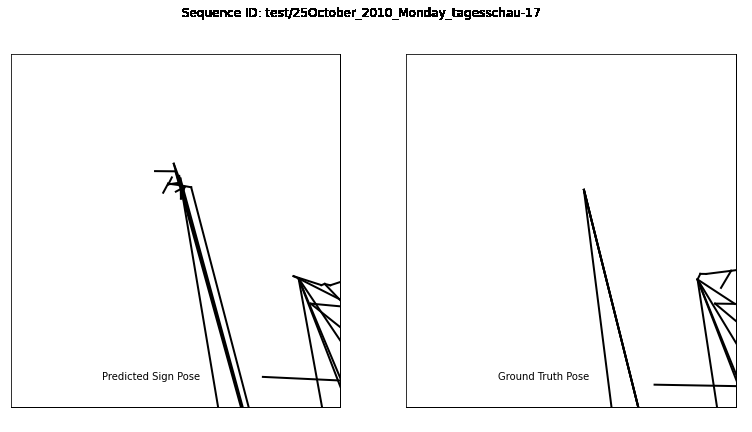

test/10March_2011_Thursday_heute-58    dtw: 44.20


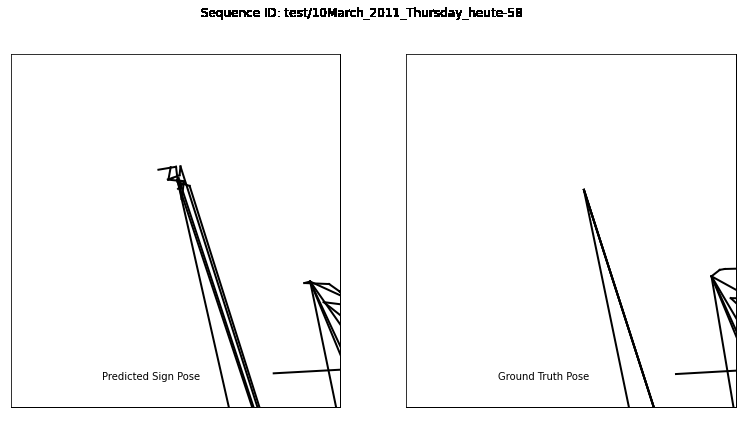

test/25October_2010_Monday_tagesschau-24    dtw: 26.37


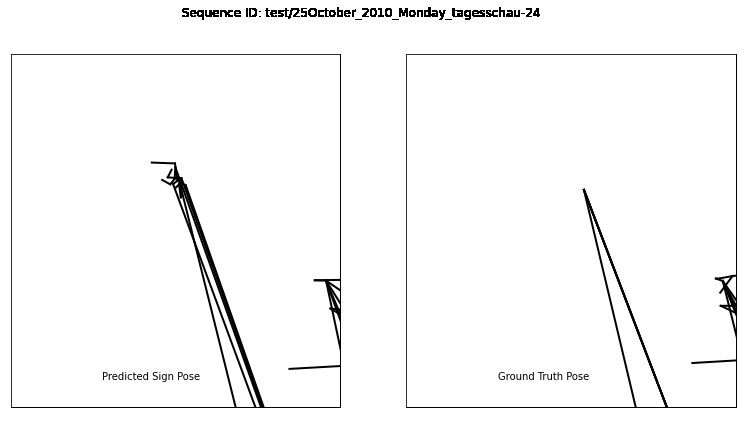

test/14August_2009_Friday_tagesschau-62    dtw: 28.36


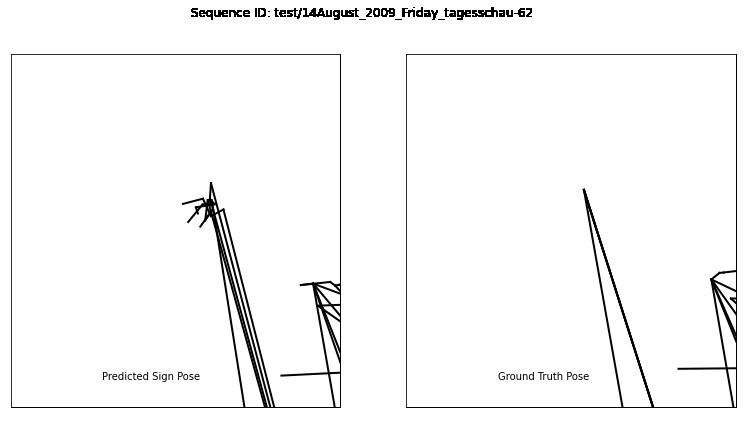

test/15December_2010_Wednesday_tagesschau-37    dtw: 22.13


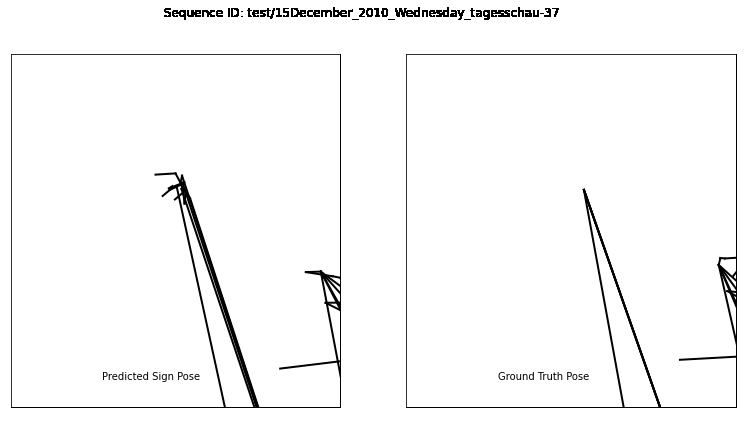

Using skeleton 1
Using skeleton 1
Using skeleton 1
Using skeleton 1
Using skeleton 1
Too few samples for reliable FID. Returning dummy value.

===== Evaluation on TEST set =====
DTW Score     : 7249.532
BT F1 Score   : 0.296
BLEU-1 Score  : 1.000
BLEU-4 Score  : 1.000
ROUGE-L Score : 1.000
WER Score     : 0.000
FID Score     : 0.000
MPJPE         : 0.349
MPJAE         : 0.172
Saved 5 skeleton sequences to './Models/Base/test.skels'
test/25October_2010_Monday_tagesschau-17    dtw: 50.12


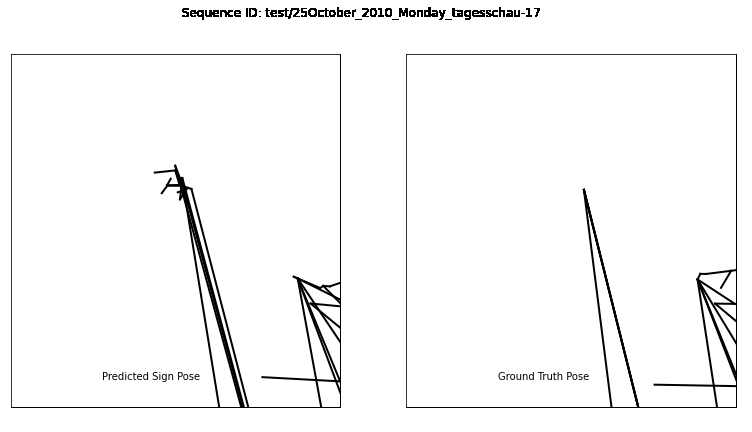

test/10March_2011_Thursday_heute-58    dtw: 43.34


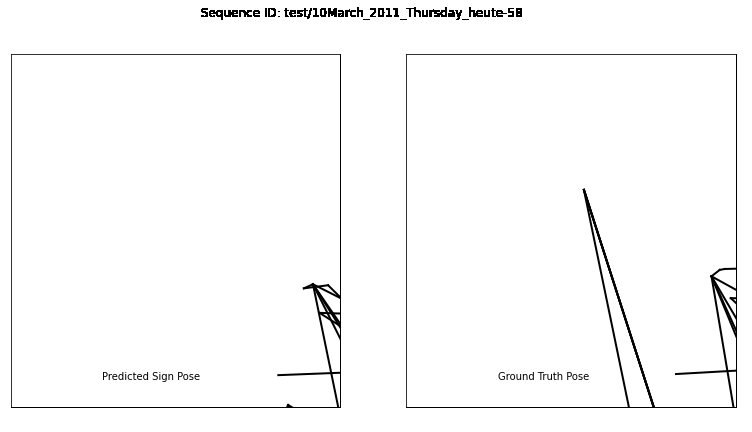

test/25October_2010_Monday_tagesschau-24    dtw: 26.65


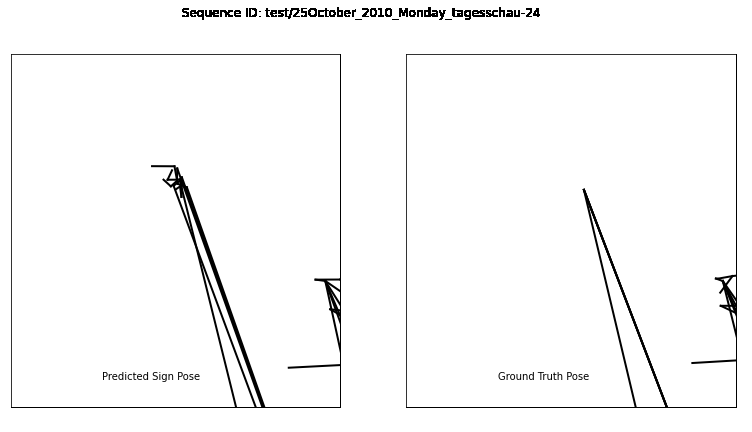

test/15December_2010_Wednesday_tagesschau-37    dtw: 24.00


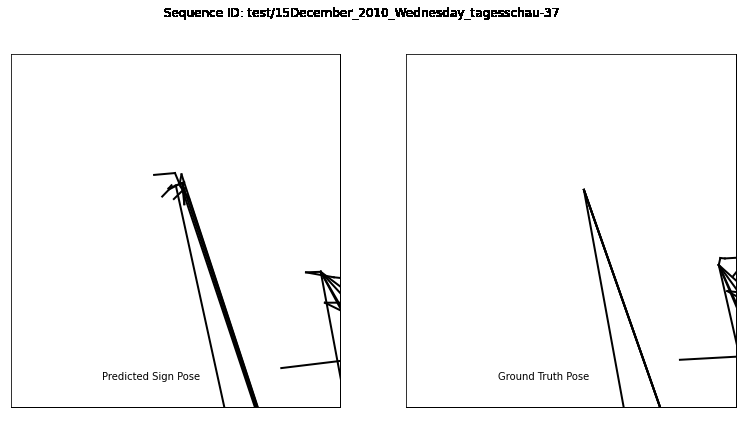

test/14August_2009_Friday_tagesschau-62    dtw: 29.27


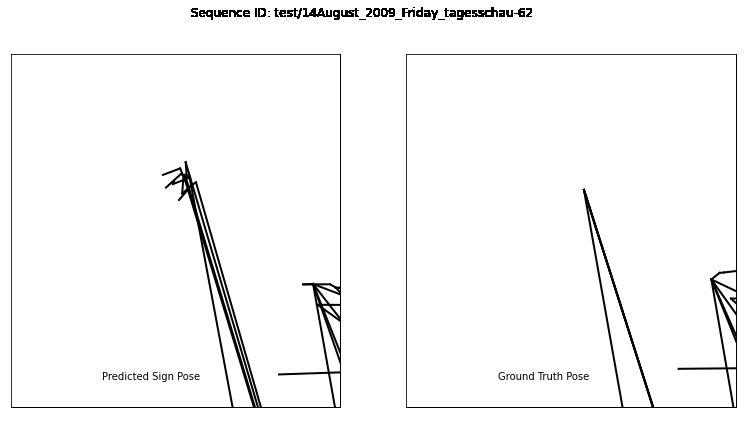

In [8]:
test(cfg_file=config_path, ckpt=ckpt)

# Data flow 

## Dataset preparation (load_data)
- glosses are tokenized, src_vocab is created (.src)
- skels are converted into a list of N(number of frames) 1d tensors of size 151 (150 keypoints + 1 frame counter)-> N frames with 150 keypoints each (.trg)
- files (mp4 paths)- no processing (.file_paths)
- each element in train_data is a triplet (.src, .trg, .file_path)

## Preprocessing and batching (make_data_iter)
- src - convert gloss tokens into indices (tensors) using vocab, group tensors based on batch size
- trg - each element has a list of 2d tensors (frames, [151]), pads all sequences in the batch acc to the sequence with max no of frames and returns a 3d tensor (batch size, frames, [151])
- file_paths - no changes
- each batch object is a dictionary of the above 3 preprocessed fields

## Training
- glosses - embedded and passed through transformer encoder layer
- target poses(skels) - passed through acd
                      - id is applied for better structural representation of the poses (3d joints are converted                           into features- 7d vector per bone (3d coordinates+bonelength+3d unit direction)
                      - diffusion (noise is added to ground truth poses)
- acd denoiser uses encoded glosses to reverse noise in the ground truth poses and produces pred_poses
- loss is calculated by comparing the original ground truth poses (without noise) and pred_poses

## Validation
- dtw scores are calculated using ground truth and predicted poses (unseen data)
- videos are rendered for best predictions (lower dtw)


### To fix
- hands


In [18]:
!{sys.executable} -m pip install torchview


Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.3/47.3 KB 488.2 kB/s eta 0:00:00a 0:00:01


In [28]:
import torch.nn as nn
class WrappedModel(nn.Module):
    def __init__(self, model):
        super().__init__()
        self.model = model
    
    def forward(self, inputs):
        return self.model(
            is_train=False,
            src=inputs[0],
            trg_input=inputs[1],
            src_mask=inputs[2],
            src_lengths=inputs[3],
            trg_mask=inputs[4]
        )


In [29]:
from torchview import draw_graph
#from wrapped_model import WrappedModel  # make sure this class is defined

cfg= load_config(config_path)
_, _, _, src_vocab, trg_vocab = load_data(cfg=cfg)
model = build_model(cfg, src_vocab, trg_vocab).to(device)
wrapped_model = WrappedModel(model)

# Extract sizes from config or model
vocab_size = len(src_vocab)
src_len = 20               # example input sentence length (you can choose 20–40)
pose_len = 30              # number of frames (temporal dimension)
pose_dim = cfg["model"]["trg_size"]  # e.g., 151

# Create dummy inputs
dummy_src = torch.randint(0, vocab_size, (1, src_len)).to(device)
dummy_trg = torch.randn(1, pose_len, pose_dim).to(device)
dummy_src_mask = torch.ones(1, 1, src_len).bool().to(device)
dummy_src_lengths = torch.tensor([src_len]).to(device)
dummy_trg_mask = torch.ones(1, 1, pose_len).bool().to(device)

input_tuple = (dummy_src, dummy_trg, dummy_src_mask, dummy_src_lengths, dummy_trg_mask)

# Visualize the model
graph = draw_graph(
    wrapped_model,
    input_data=(input_tuple,),
    input_size=None,
    expand_nested=True,
    save_graph=True,
    directory=".",
    filename="model_architecture",
    roll=True
)

graph.visual_graph  # displays inside Jupyter


In [13]:
from constants import TARGET_PAD
TARGET_PAD

0.0